In [13]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from utils import * 
from harris import *

Images loaded successfully!


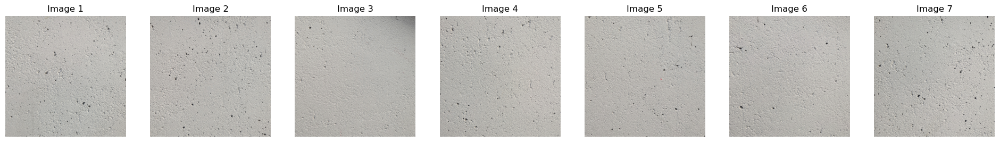

In [31]:
path = "C:\\Users\\ragsh\\Desktop\\FALL 24\\RSN\\LAB5\\data-2"
images = load_images(path)

In [39]:


def detect_and_compute_keypoints(img,show_corners = False,harris_params={}):
    """
    Detect keypoints using Harris Corner Detector and compute descriptors using SIFT.
    """
    # Initialize SIFT and convert image to grayscale
    sift = cv2.SIFT_create()
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    
    y_coords, x_coords, response = harris(gray, **harris_params)

    keypoints = [cv2.KeyPoint(float(x), float(y), 1) for y, x in zip(y_coords, x_coords)]
    
    # Compute descriptors for detected keypoints using SIFT
    keypoints, descriptors = sift.compute(img, keypoints)
    
    ## displaying harris corner detection output
    if show_corners:
        img_with_corners = img.copy()
        for y, x in zip(y_coords, x_coords):
            img_with_corners[int(y), int(x)] = [0, 0, 255]  # Mark corners in red
        plt.figure(figsize=(8, 8))
        plt.imshow(cv2.cvtColor(img_with_corners, cv2.COLOR_BGR2RGB))
        plt.title("Custom Harris Corners Detection")
        plt.axis("off")
        plt.show()

           

    return keypoints, descriptors


In [41]:

def stitch_images(img1, img2, kp1, kp2, matches):
    """
    Stitch two images together using matched keypoints and RANSAC to find homography.
    This version adds padding based on detected alignment (left or right).
    """
    # Extract matched keypoints
    img1_pts = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
    img2_pts = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)
    
    # Compute homography matrix using RANSAC
    H, mask = cv2.findHomography(img1_pts, img2_pts, cv2.RANSAC, 8.0)
    img1_warped, img2_padded = warpPerspectivePadded(img1, img2, H)
    stitched_image = masking(img1_warped, img2_padded, 0.1)
    result = np.uint8(stitched_image)
    
    return result

In [35]:
def create_panorama(images, show_corners=False, harris_params={}):
    """
    Create a panorama from a list of images.
    """
    stitched_image = images[0]  # Start with the first image
    for i in range(1, len(images)):
        print(f"Stitching image {i-1} and {i}...")
        
        # Detect keypoints and descriptors with custom Harris and SIFT
        keypoints1, descriptors1 = detect_and_compute_keypoints(stitched_image, show_corners=show_corners, harris_params=harris_params)
        keypoints2, descriptors2 = detect_and_compute_keypoints(images[i], show_corners=show_corners, harris_params=harris_params)
        
        # Match features between descriptors
        matches = match_features(descriptors1, descriptors2)
        print(f"Number of good matches between stitched image and image {i}: {len(matches)}")

        # Optionally draw matches
        draw_matches(stitched_image, images[i], keypoints1, keypoints2, matches, num_matches=50)
        
        # Stitch the current image with the next in sequence
        stitched_image = stitch_images(stitched_image, images[i], keypoints1, keypoints2, matches)
        
    
    return stitched_image

Stitching image 0 and 1...


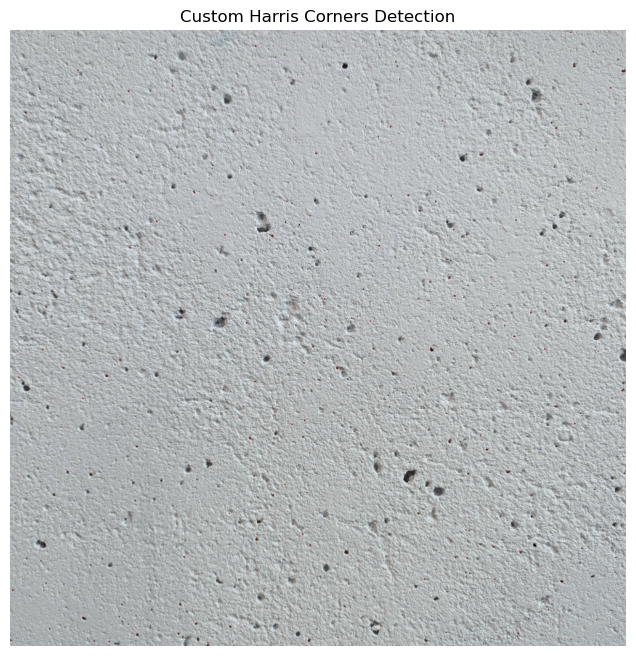

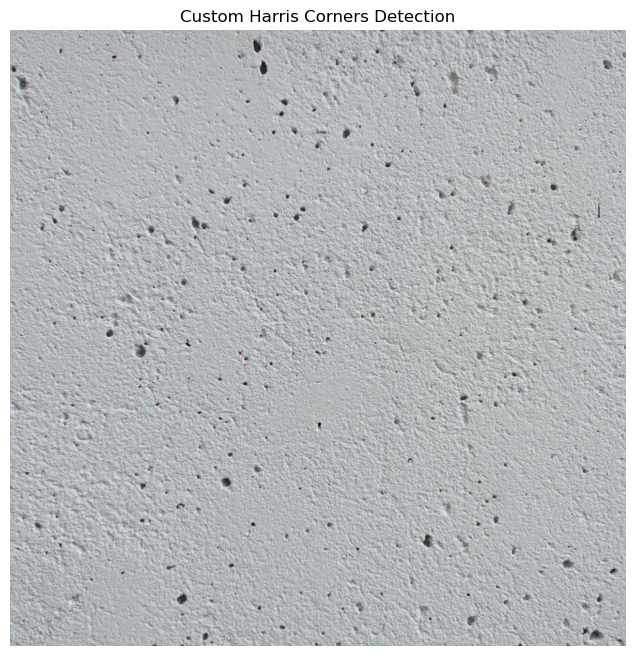

Number of good matches between stitched image and image 1: 22


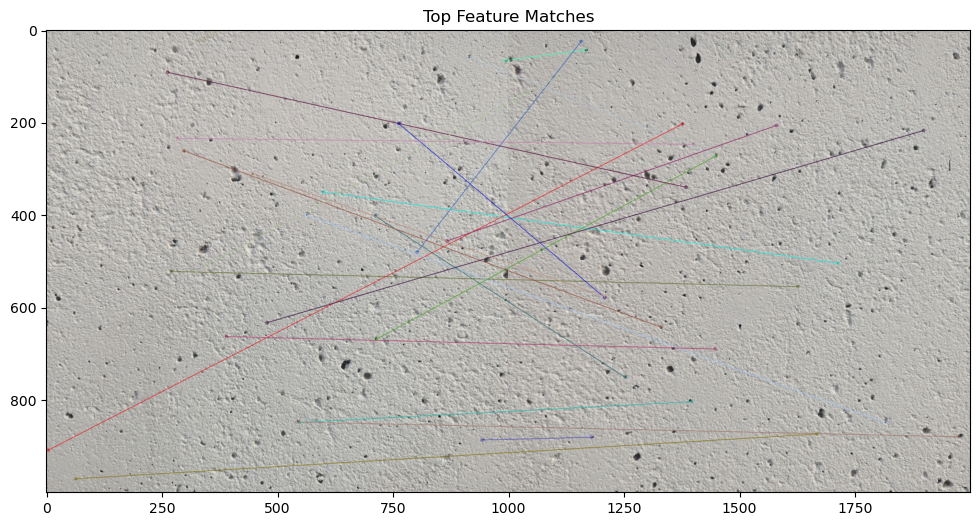

Stitching image 1 and 2...


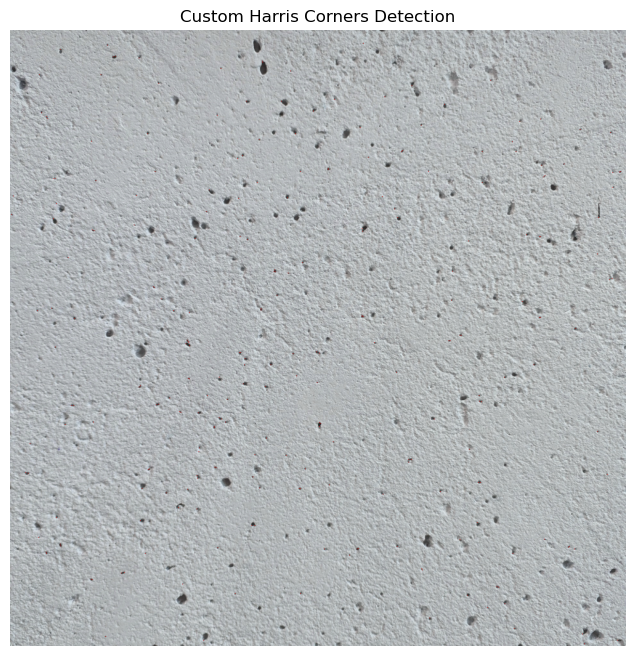

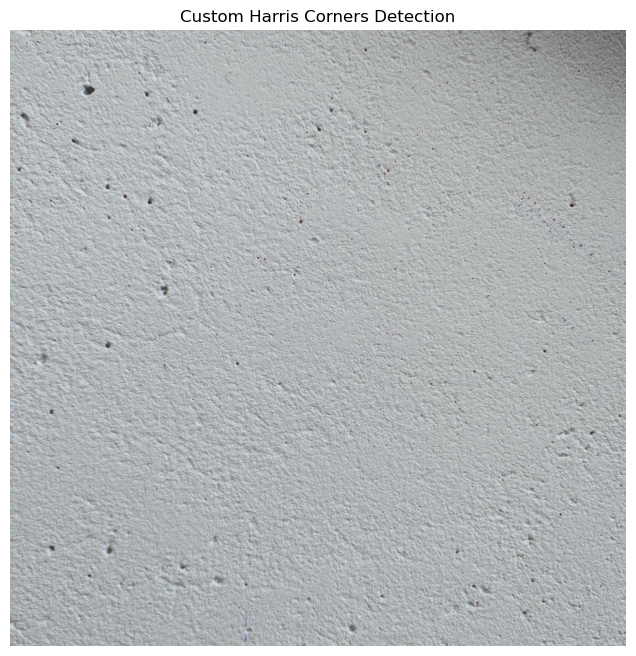

Number of good matches between stitched image and image 2: 26


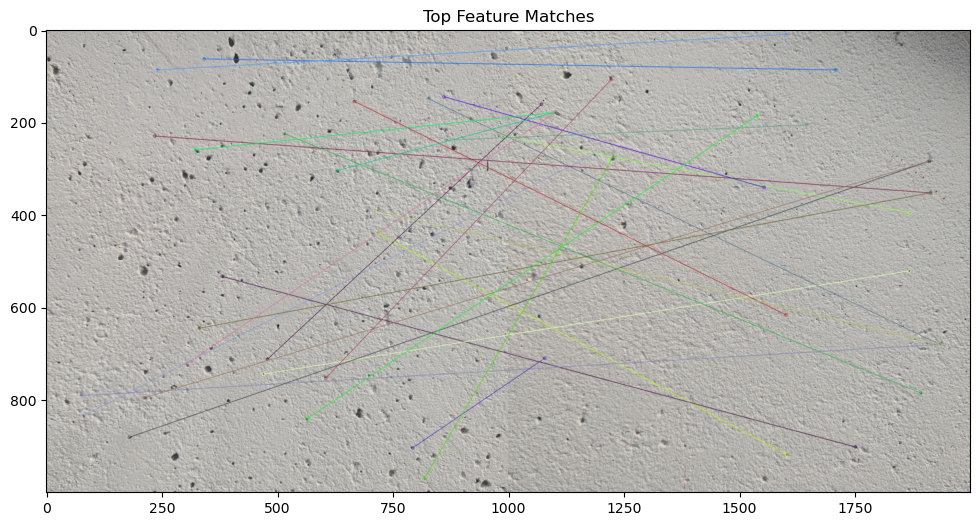

Stitching image 2 and 3...


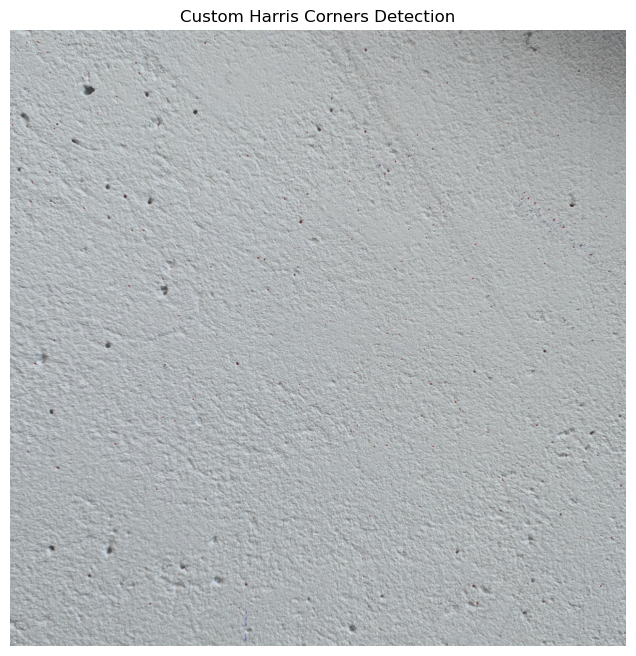

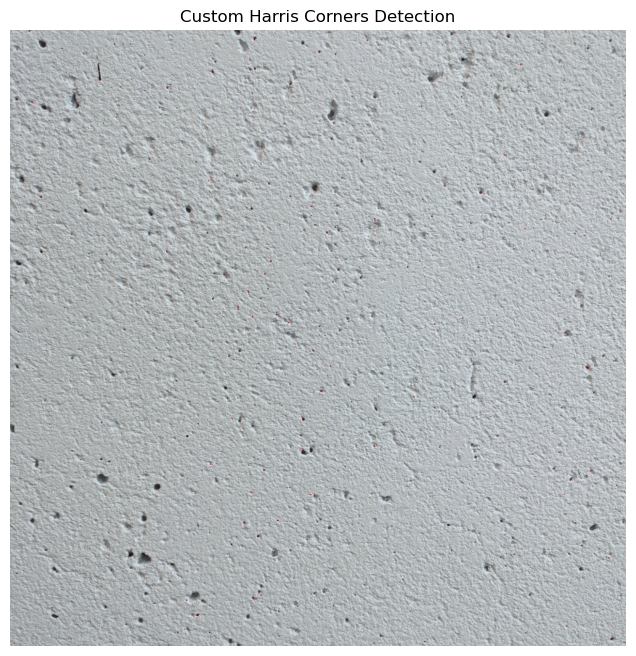

Number of good matches between stitched image and image 3: 23


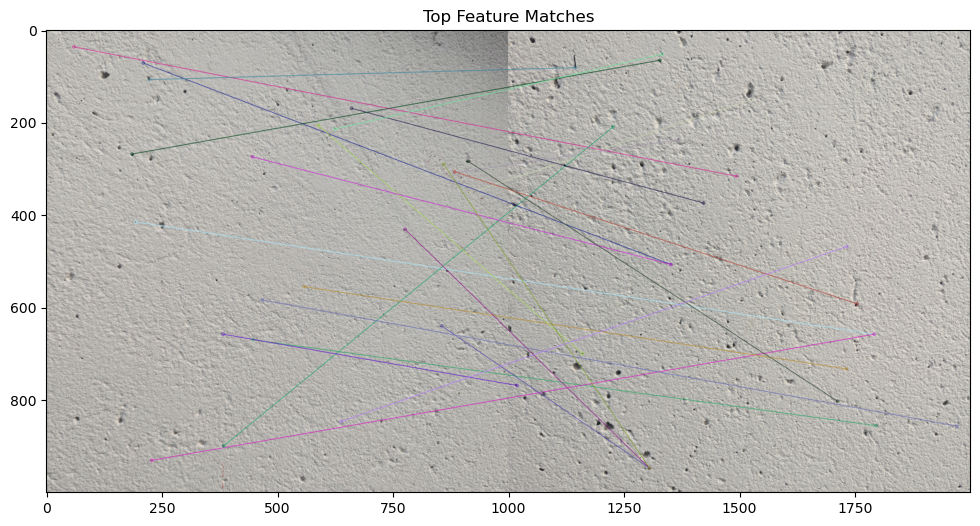

Stitching image 3 and 4...


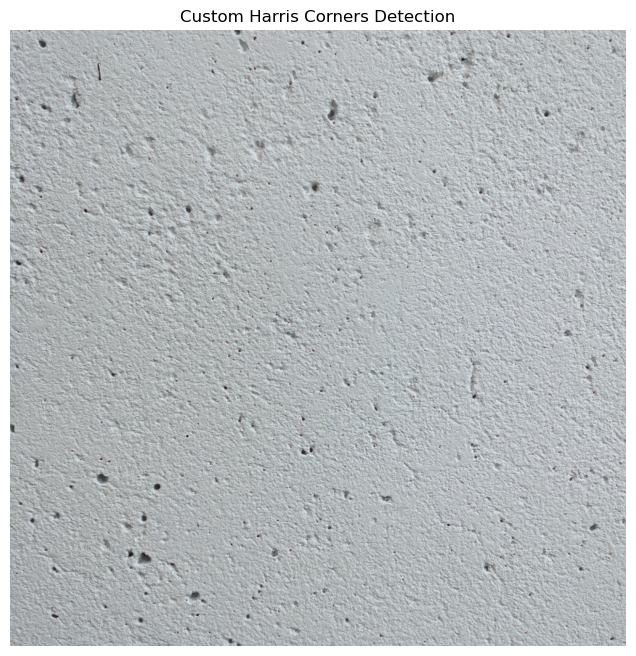

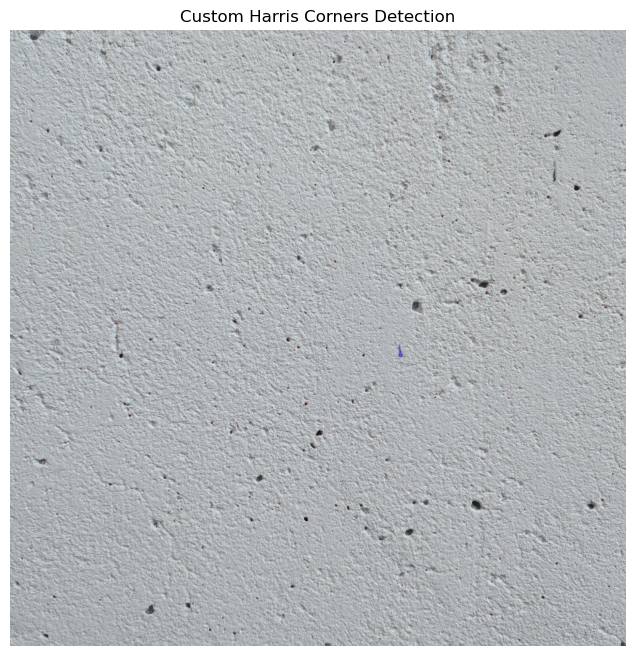

Number of good matches between stitched image and image 4: 28


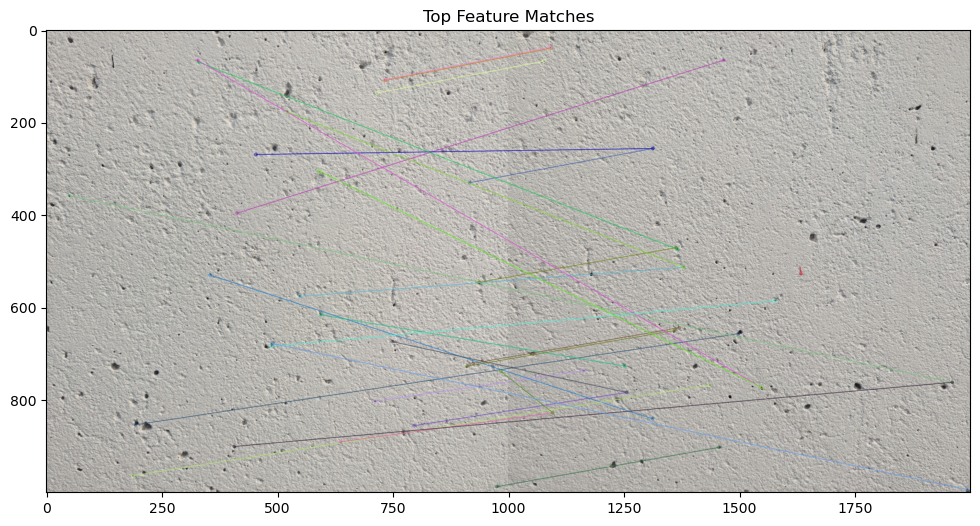

Stitching image 4 and 5...


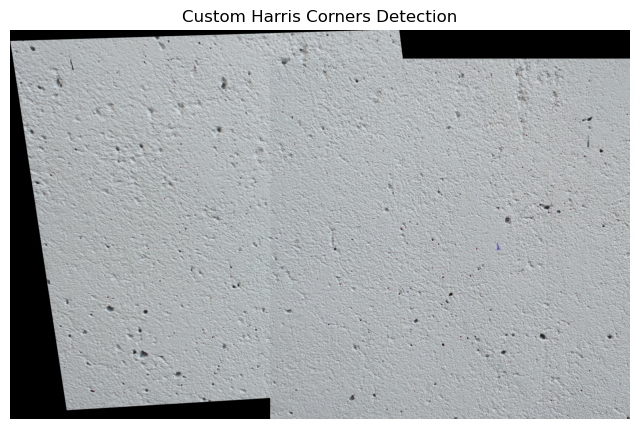

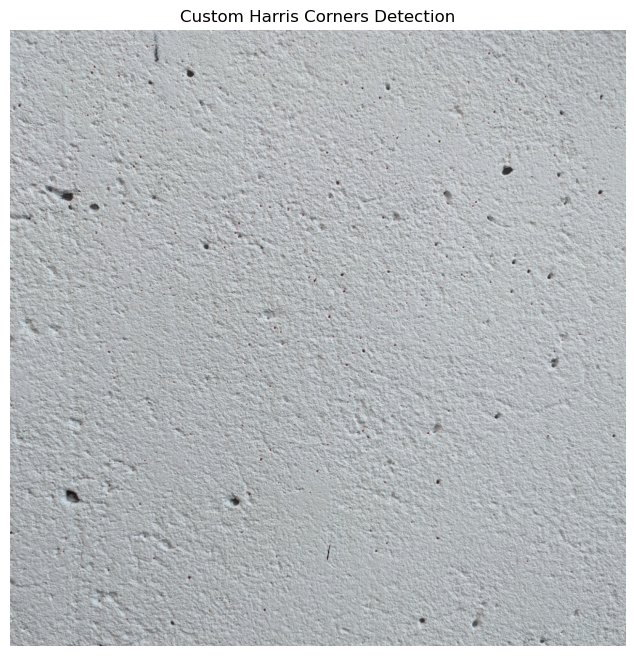

Number of good matches between stitched image and image 5: 24


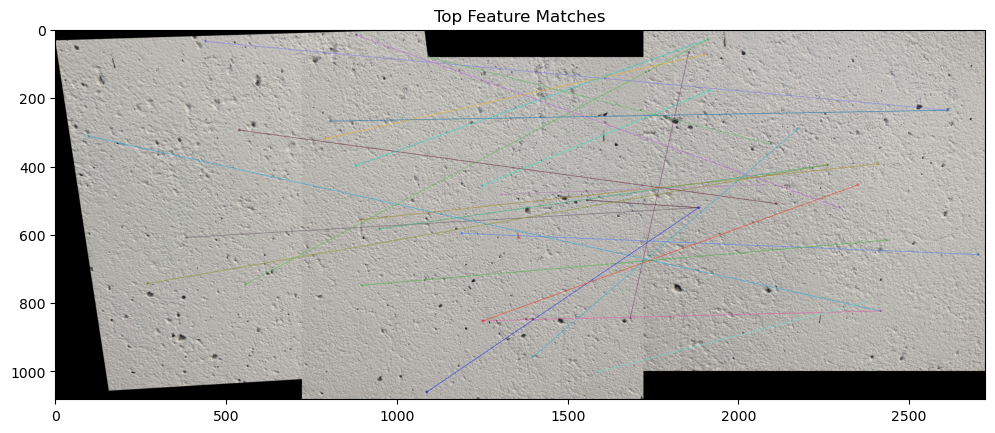

Stitching image 5 and 6...


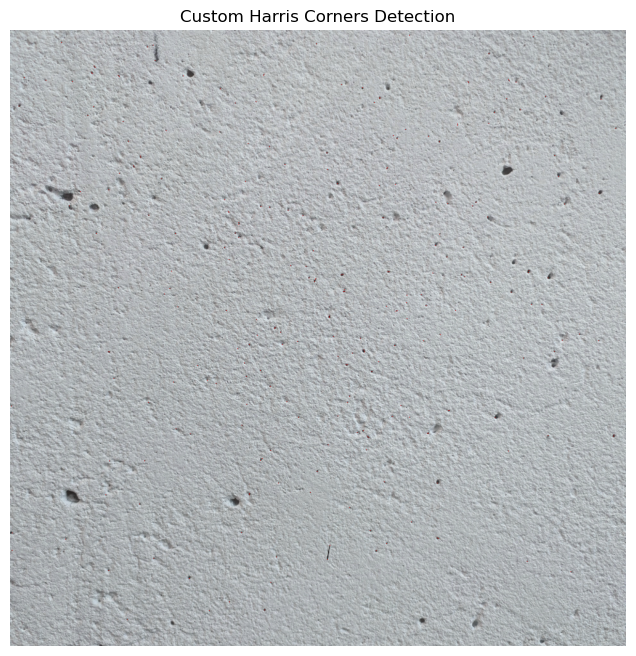

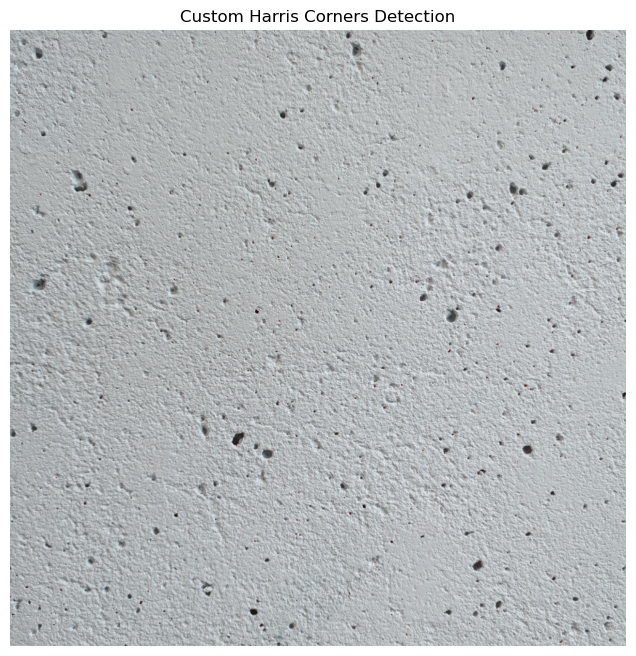

Number of good matches between stitched image and image 6: 19


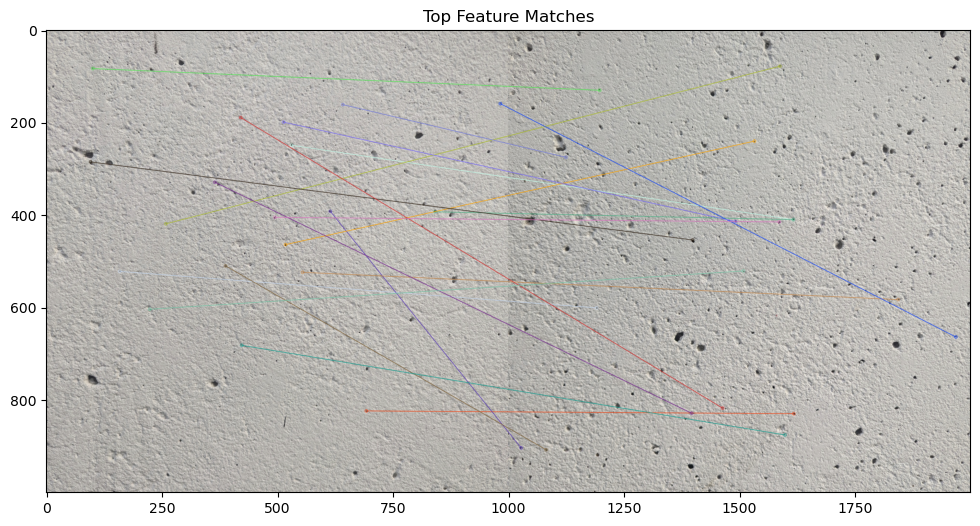

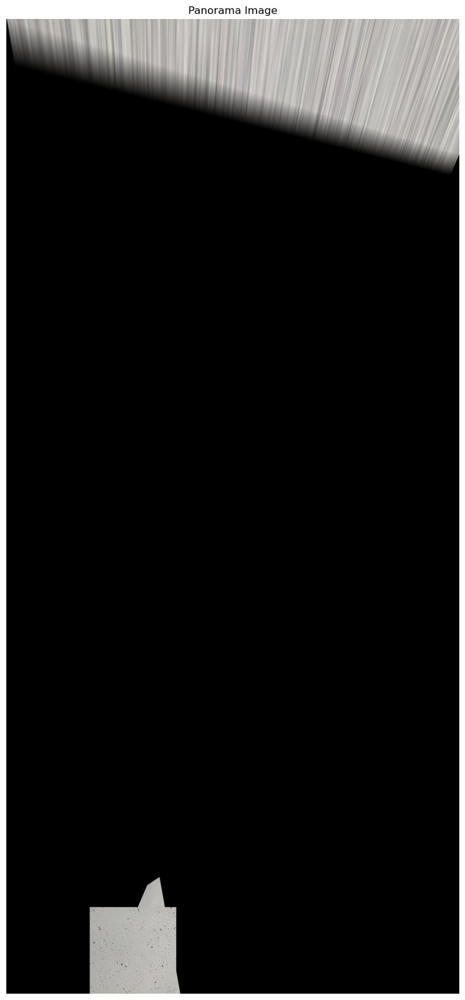

In [43]:


harris_params = {
        
        'disp': False,
        'N': 250,
        'thresh': 0.01,
        'hsize': 2,
        'sigma': 0.6,
        'eig': True,
        'tile': [1,1],
        'mask': None,
        'fft': False,
    }
panorama = create_panorama(images, show_corners=True, harris_params=harris_params)


# Display the final panorama
plt.figure(figsize=(30, 20))
plt.imshow(panorama)
plt.title("Panorama Image")
plt.axis("off")
plt.show()